# Day 2: Image functions

In [1]:
# importing needed libraries globally
from PIL import Image # for reading images
import numpy as np # for arrays manipulations
import matplotlib.pyplot as plt # for 2D plottings
from skimage import color
from mpl_toolkits.mplot3d import Axes3D # for 3D plotting

## Image as a function

In [2]:
# some needed imports
from cycler import cycler # for cycling rgb
default_cycler = (cycler(color=['r', 'g', 'b', 'y']))
plt.rc('axes', prop_cycle=default_cycler)

In [3]:
# defining functions
def draw_h_line(imarray,p):
    """
    Receive 3 channel image and draw horizontal line at @p 
    """
    from skimage.draw import line_aa
    if len(imarray.shape) > 2:
        h,w,_ = imarray.shape
        value = [0,0,0]
    else:
        h,w = imarray.shape
        value = [0]
    rr, cc, val = line_aa(p, 0, p, w-1)
    imarray[rr,cc] = value

def draw_v_line(imarray,p):
    """
    Receive 3 channel image and draw vertical line at @p 
    """
    from skimage.draw import line_aa
    if len(imarray.shape) > 2:
        h,w,_ = imarray.shape
        value = [0,0,0]
    else:
        h,w = imarray.shape
        value = [0]
    h,w,_ = imarray.shape
    rr, cc, val = line_aa(0, p, h-1, p)
    imarray[rr,cc] = value 
    
    
def plot_row(imarray,index,ax=None):
    """
    Receive 1 channel of an image and plot row at @index 
    """
    y = imarray[index,:]
    x = np.arange(len(y))
    if ax is None:
        plt.plot(x,y)
    else:
        ax.plot(x,y)
# defining functions
def plot_col(imarray,index,ax=None):
    """
    Receive 1 channel of an image and plot col at @index 
    """
    y = imarray[:,index]
    x = np.arange(len(y))
    if ax is None:
        plt.plot(x,y)
    else:
        ax.plot(x,y)

def plot_3d(imarray):
    """
    Receivean 1 channel image and plot it as function in 3d
    """
    w,h = imarray.shape
    fig = plt.figure(figsize=(10, 10))
    ax1 = fig.add_subplot(111, projection='3d')
    _x = np.arange(w)
    _y = np.arange(h)
    for x in _x:
        ax1.plot([x]*h,_y,imarray[x,:])
        
def red(im):
    """
    Receive multi channels of an image and return the red channel
    """
    return im[:,:,0]
def green(im):
    """
    Receive multi channels of an image and return the green channel
    """
    return im[:,:,1]
def blue(im):
    """
    Receive multi channels of an image and return the blue channel
    """
    return im[:,:,2]

def gray(im):
    """
    Receive multi channels of an image and return a gray
    """
    return color.rgb2gray(im)
def imread(imgfile,numpy=False):
    """
    read an image as numpy array and make it mutatable
    """
    img = Image.open(imgfile)
    if numpy:
        img = np.asarray(img)
        return img.copy()
    else:
        return img
def plot_grid(imarrays,titles,figsize=(10,10)):
    """
    show four images
    """
    count = 1
    plt.figure(figsize=figsize)
    for im,t in zip(imarrays,titles):
        plt.subplot(220+count)
        ax = plt.gca()
        ax.xaxis.set_major_locator(plt.NullLocator())
        ax.yaxis.set_major_locator(plt.NullLocator()) 
        count += 1
        if len(im.shape) < 3:
            plt.imshow(im,cmap="gray")
        else:
            plt.imshow(im)
        plt.title(t, size=20)
    plt.gcf().set_tight_layout(True)
    plt.show()

def plot_row_with_image(img,rownum,ax1,ax2):
    img_copy = img.copy()
    if len(img_copy.shape) > 2:
        h,w,_ = img_copy.shape
        ax1.imshow(img_copy)
    else:
        h,w = img_copy.shape
        ax1.imshow(img_copy,cmap="gray")
    draw_h_line(img_copy,rownum)
    plot_row(img, rownum,ax2)
    
def normalize_img(s):
    """
    Receive image in any data types and range and normalize it
    to [0,255]
    """
    start = 0
    end = 255
    width = end - start
    res = (s - s.min())/(s.max() - s.min()) * width + start
    return res

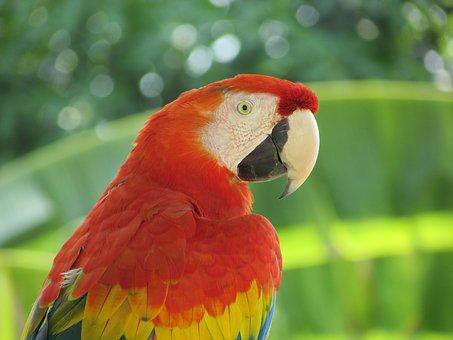

In [4]:
# Openning parrot image 
parrot = imread("imgs/parrot.png")
parrot

In [5]:
# convert the image to ND array
p_arr = imread("imgs/parrot.png",True)
p_arr.shape

(340, 453, 3)

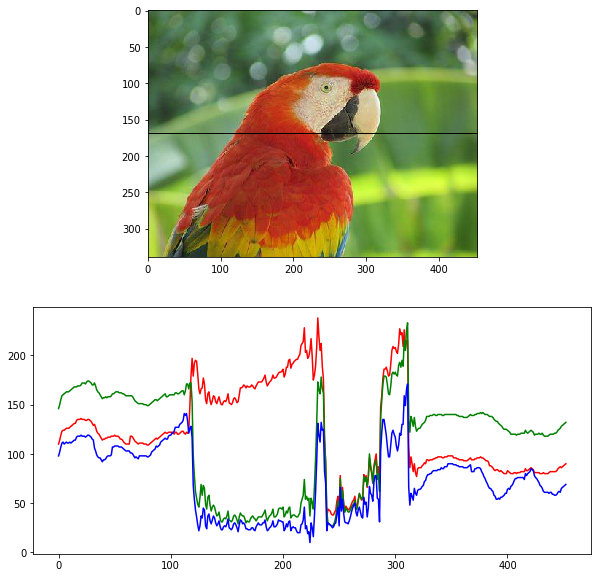

In [6]:
# plotting center row
%matplotlib inline
# make a copy
p_arr_copy = p_arr.copy()
# dimensions
height,width,channels = p_arr.shape
# make a plot
fig, ax = plt.subplots(nrows=2,figsize=(10,10))
# draw horizontal line on the image copy
draw_h_line(p_arr_copy,height//2)
# show the image
ax[0].imshow(p_arr_copy)
# plot the row
plot_row(p_arr, height//2,ax[1])

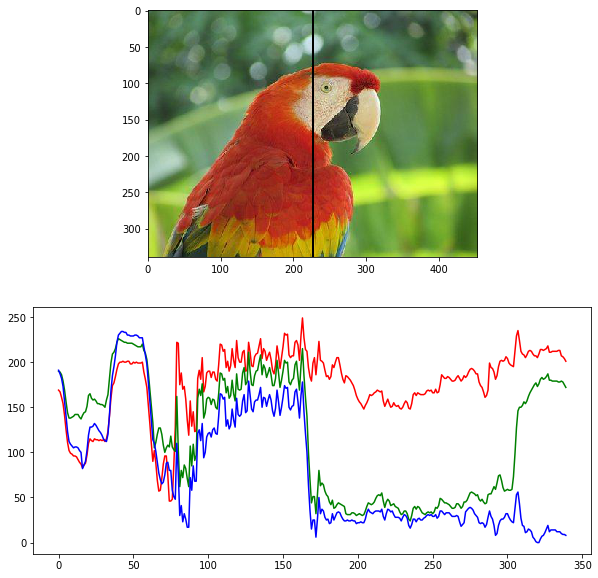

In [7]:
# plotting center col
# make a copy
p_arr_copy = p_arr.copy()
# get dimensions
height,width,channels = p_arr.shape
# create figure
fig, ax = plt.subplots(nrows=2,figsize=(10,10))
# draw vertical line on the image copy
draw_v_line(p_arr_copy,width//2)
draw_v_line(p_arr_copy,width//2+1)
draw_v_line(p_arr_copy,width//2-1)
# show the image
ax[0].imshow(p_arr_copy,cmap="gray")
# plot the column 
plot_col(p_arr, width//2,ax[1])

In [8]:
# plotting all rows in 3D
# %matplotlib notebook
# plot_3d(red(p_arr))

When we deal with images as functions, we can make use of all functions powerful tools (e.g. interpolation, convolvement, filters, and transformations). Lets

### Restoration

In [9]:
def add_salt_and_pepper(gb, prob):
    '''Adds "Salt & Pepper" noise to an image.
    gb: should be one-channel image with pixels in [0, 1] range
    prob: probability (threshold) that controls level of noise'''

    rnd = np.random.rand(gb.shape[0], gb.shape[1])
    noisy = gb.copy()
    noisy[rnd < prob] = 0
    noisy[rnd > 1 - prob] = 1
    return np.uint8(noisy)

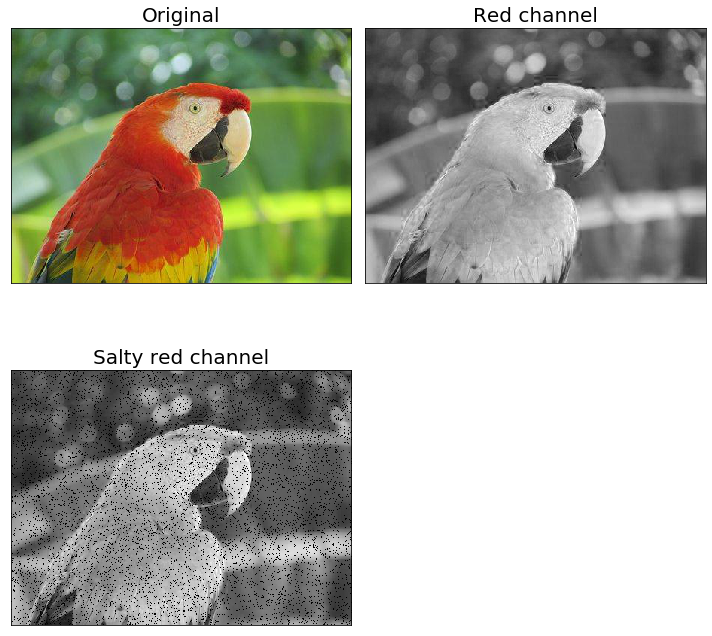

In [10]:
# adding salt and pepper noise to our image
%matplotlib inline
parrot = imread("imgs/parrot.png",True)
red_parrot = red(parrot)
salty_parrot = add_salt_and_pepper(red_parrot,0.04)
plot_grid([parrot,red_parrot,salty_parrot],
         ["Original","Red channel","Salty red channel"])

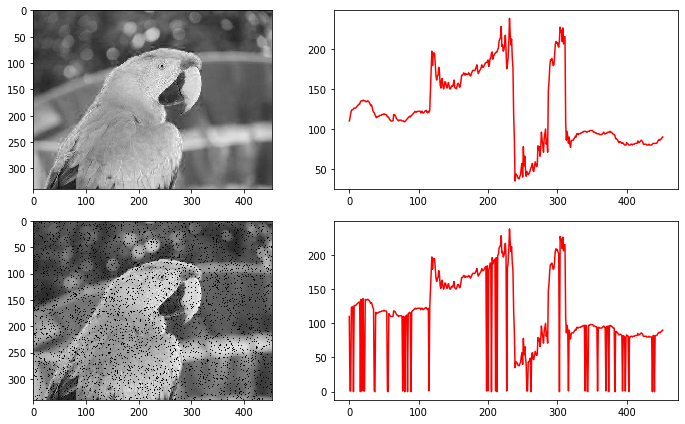

In [11]:
# plotting center row
h,_ = red_parrot.shape
fig, ax = plt.subplots(ncols=2,nrows=2)
fig.set_size_inches((10,6))
fig.set_tight_layout(True)
plot_row_with_image(red_parrot,h//2,ax[0,0],ax[0,1])
plot_row_with_image(salty_parrot,h//2,ax[1,0],ax[1,1])

**Moving average**

In [12]:
def moving_average(a, n=3) :
    """
    Calculate a moving average for a series
    """
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

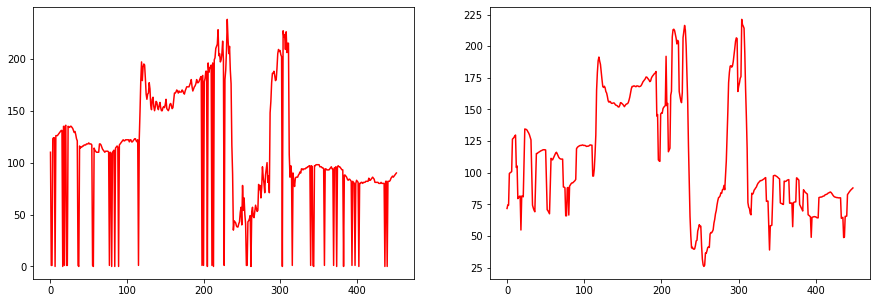

In [13]:
# image dimension
h,_ = red_parrot.shape
# salty middle raw
mrow = salty_parrot[h//2]
# cleaned middle row
cleaned = moving_average(mrow,5)
# plotting
fig, ax = plt.subplots(ncols=2,figsize=(15,5))
ax[0].plot(mrow)
ax[1].plot(cleaned)

**Weighted moving average**

In [14]:
def weighted_moving_average(a,weights=np.array([1,4,6,4,1])):
    """
    Calculate the weighted moving average for a series
    """
    s = sum(weights)
    n = len(weights)
    h = n//2
    ret = [np.dot(a[i-h:i+h+1],weights)//s for i in range(h,len(a)-h)]
    return ret

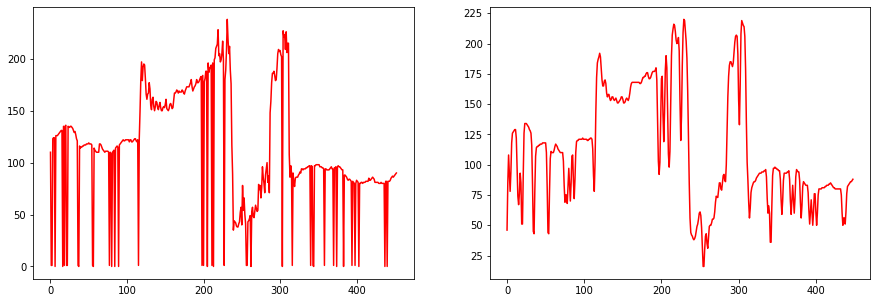

In [15]:
h,_ = red_parrot.shape
mrow = salty_parrot[h//2]
cleaned = weighted_moving_average(mrow)
fig, ax = plt.subplots(ncols=2,figsize=(15,5))
ax[0].plot(mrow)
ax[1].plot(cleaned)

**Moving average in 2D**

In [16]:
def moving_average_2d(a, n=3) :
    """
    Calculate the moving average for an image
    """
    w,h = a.shape
    m = n*n
    half = n//2
    x = np.copy(a)
    for i in range(half,w-half):
        for j in range(half,h-half):
            s = round(sum(a[i-half:i+half+1,j-half:j+half+1].flatten()))
            x[i,j] = s/float(m)
    return x

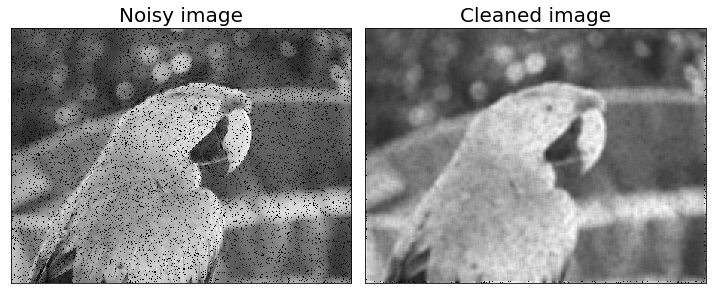

In [17]:
cleaned = moving_average_2d(salty_parrot,n=7)
plot_grid([salty_parrot,cleaned],["Noisy image","Cleaned image"])

**Now using scipy**

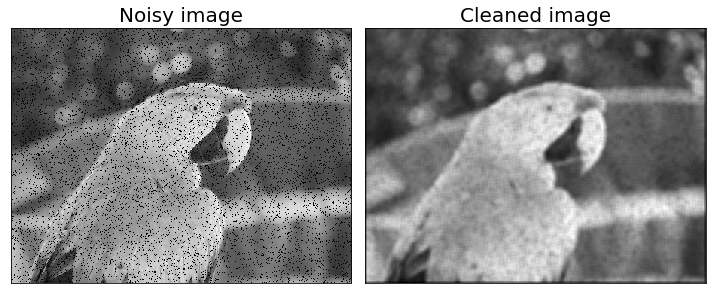

In [18]:
## Using uniform filter
from scipy.ndimage import uniform_filter
cleaned = uniform_filter(salty_parrot, size=7, mode='constant')
plot_grid([salty_parrot,cleaned],["Noisy image","Cleaned image"])

HMMMMMMMM!!

That doesn't seems to be good cleaning. How about other filters?!!

scipy comes with plenty of great denoising filters. The idea here is not to compare these filters but to show the underlying concept behind them. The secret word is <font color="red">IMAGE AS A FUNCTION</font>

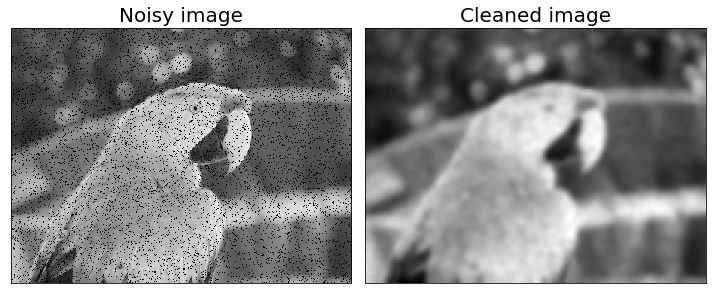

In [19]:
## Using gaussian filter
from scipy.ndimage import gaussian_filter
cleaned = gaussian_filter(salty_parrot, sigma=4)
plot_grid([salty_parrot,cleaned],["Noisy image","Cleaned image"])

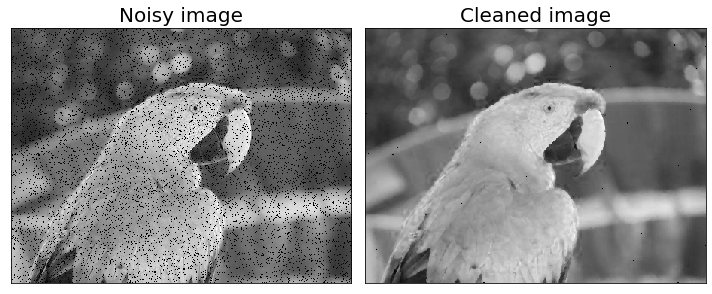

In [20]:
## THE MAGICAL Median filter
from scipy.ndimage import median_filter
cleaned = median_filter(salty_parrot, (3,3))
plot_grid([salty_parrot,cleaned],["Noisy image","Cleaned image"])

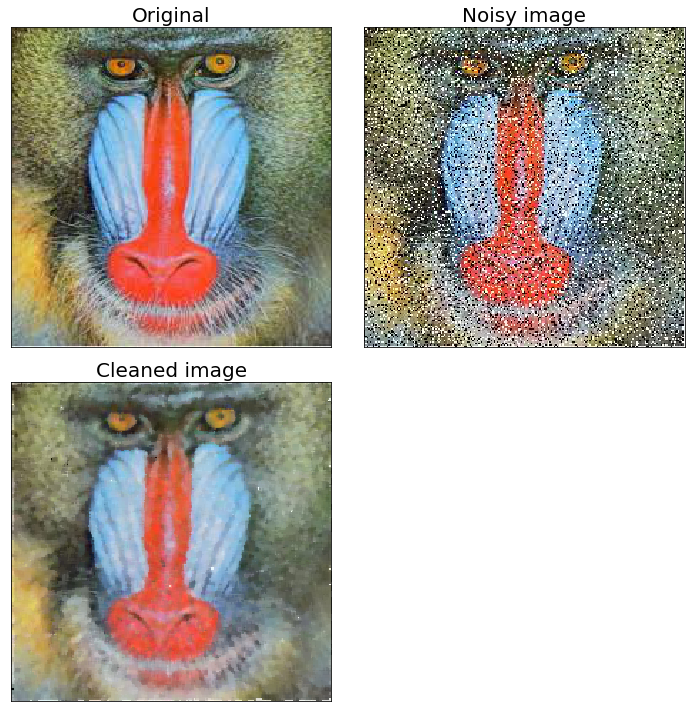

In [21]:
## Finally in color
mandrill = imread("imgs/mandrill.jpg",True)
noisy_mandrill = imread("imgs/mandrill_spnoise_0.3.jpg",True)
cleaned = median_filter(noisy_mandrill, (4,4,1))

plot_grid([mandrill,noisy_mandrill,cleaned],["Original","Noisy image","Cleaned image"])

### Resizing (make larger)

Similar to restoration, upscaling an image requires reconstruction of the image function. However, unless the original function is known, such reconstruction is hard due to many uncertainties. Thankfully, there are many good direct functions to resize an image with quite good quality. We will look at some of these.

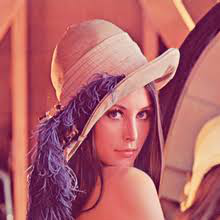

In [22]:
imread("imgs/lena.jpg")

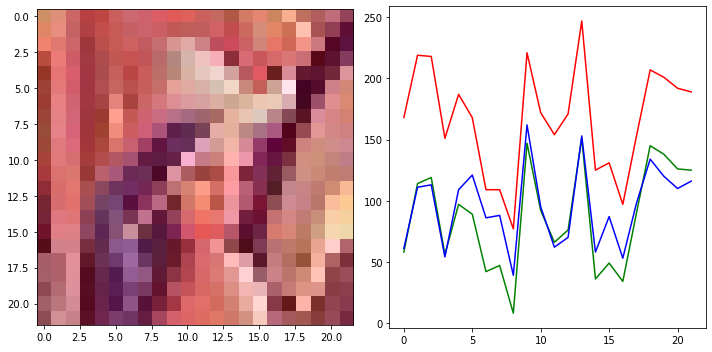

In [23]:
# plotting center row
# reading lena
lena_small = imread("imgs/lena_small.jpg",True)
# getting dimensions
h,w,_ = lena_small.shape
# creating figure
fig, ax = plt.subplots(ncols=2, figsize=(10,5))
fig.set_tight_layout(True)
# plotting middle row
plot_row_with_image(lena_small,h//2,ax[0],ax[1])

In [24]:
# Showing the red row
red_row = lena_small[h//2,:,0]
plt.axis('off')
plt.imshow(red_row.reshape((-1,red_row.shape[0])),cmap="gray")

In [25]:
## Interpolating
## range [0,22]
x = np.arange(red_row.shape[0])
# middle red row in lena
y = red_row
# linspace [0-200]
xi = np.linspace(0,red_row.shape[0],200)
# interpolation
yi = np.interp(xi, x, y)

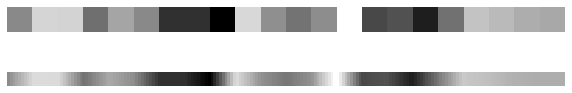

In [26]:
fig,ax = plt.subplots(nrows=2,figsize=(10,2))
ax[0].axis('off')
ax[1].axis('off')
ax[0].imshow(red_row.reshape((-1,red_row.shape[0])),cmap="gray")
yi_p = np.tile(yi,5).reshape(5,yi.shape[0])
ax[1].imshow(yi_p,cmap="gray")

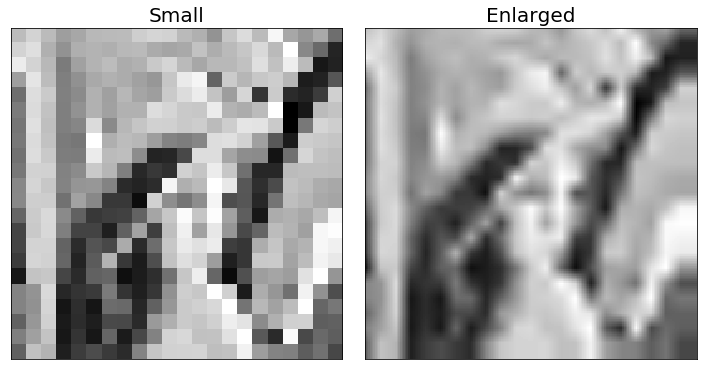

In [27]:
#dirty interpolating
def interpolate(y):
    x = np.arange(y.shape[0])
    xi = np.linspace(0,y.shape[0],200)
    return np.interp(xi, x, y)

# applying interpolation on the rows
large_red = np.apply_along_axis(interpolate, 1, red(lena_small))
# applying interpolation on the columns
large_red = np.apply_along_axis(interpolate, 0, large_red)
plot_grid([red(lena_small),large_red],["Small","Enlarged"])

**Other interpolation techniques**

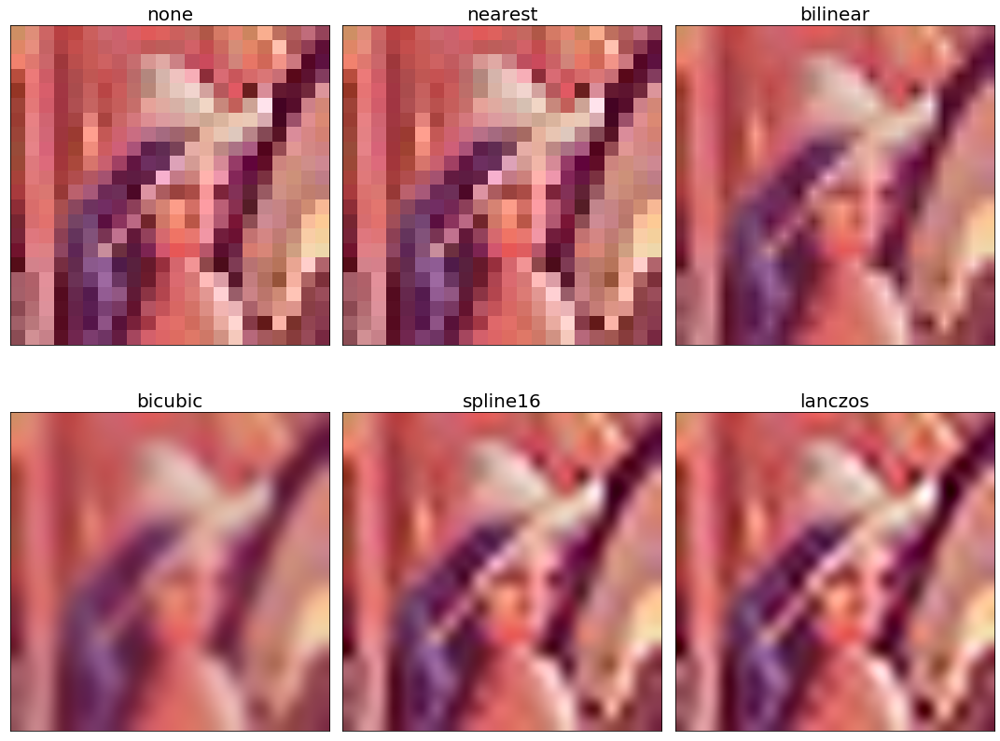

In [28]:
im = imread("imgs/lena_small.jpg",True)
methods = ['none', 'nearest', 'bilinear', 'bicubic', 'spline16', 'lanczos']
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 12), subplot_kw={'xticks': [], 'yticks': []})
fig.subplots_adjust(hspace=0.05, wspace=0.05)
for ax, interp_method in zip(axes.flat, methods):
    ax.imshow(im, interpolation=interp_method)
    ax.set_title(str(interp_method), size=20)
plt.tight_layout()
plt.show()

<font color="red">STAY TUNED, WE WILL SHOW HOW TO DO SUPER RESOLUTION WITH DEEP LEARNING</font>

## Frequency Domain

You can think of an image as a signal. A signal that comes in 2D. If that is the case, then according to Jean Baptiste Joseph Fourier's crazy idea, any periodic function (signal) can be rewritten as a weighted sum of sines and cosines of different frequencies. 

   
### A sum of sines

Our building block:

$ A*sin(\omega*x+\varphi)$

Add enough of them to get any signla f(x) you want

**Example**

<center>
<font size="2px">
            $A*\sum_{k=1}^{\infty}{\frac{1}{k}}sin(2*\pi*k*t) $
</font>
</center>

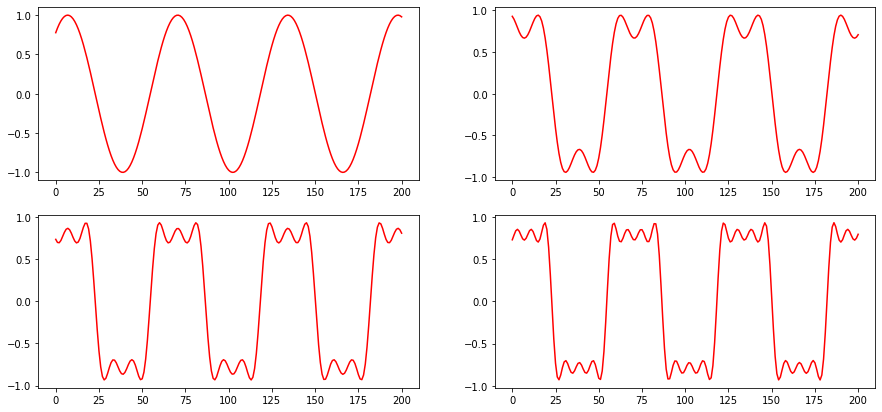

In [29]:
at = lambda t,k: + (1.0/k)*np.sin(2*np.pi*k*t)
Ampl = 1
x = np.linspace(np.pi, 2*np.pi, 201)
fig, ax = plt.subplots(2,2)
fig.set_size_inches(15,7)
pis = [(0,0),(0,1),(1,0),(1,1)]
for i in range(1,5):
    y = np.array([at(xi,1) for xi in x])
    for k in range(1,i):      
        y += Ampl*np.array([at(xi,2*k+1) for xi in x])
    ax[pis[i-1][0],pis[i-1][1]].plot(y)

Text(0.5, 0, 'frequency')

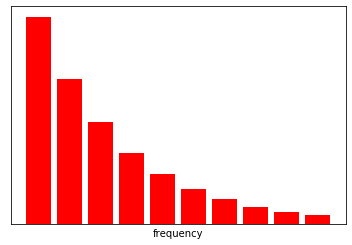

In [30]:
plt.bar(np.arange(10),[0.7**x for x in np.arange(10)])
ax = plt.gca()
ax.xaxis.set_major_locator(plt.NullLocator())
ax.yaxis.set_major_locator(plt.NullLocator())
ax.set_xlabel("frequency")

<a href="https://betterexplained.com/articles/an-interactive-guide-to-the-fourier-transform/">Better explained here</a>

### Fourier Transform

Represent the signal as an infinite weighted sum of an infinite number of sinusoids:



<img src="imgs/fig_2.png" />

In [31]:
# time function
fx = lambda t:  1+np.sin(6*np.pi*t)
# angular function
fw = lambda f,t: fx(t)*np.exp(2*np.pi*1.j*f*t)
# period 4
x = np.linspace(0, 4, 300)
# time function
y = fx(x)

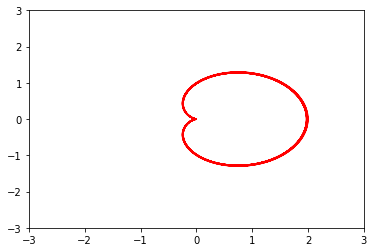

In [32]:
# showing time domain periodic function in circular wrapping
import matplotlib.animation

fig, ax = plt.subplots()
ax.set_xlim(-3,3)
ax.set_ylim(-3,3)
l, = ax.plot([], [])  
def animate(i):
    a = (3+i/100)%3.01
    yi = [fw(a,t) for t in x]
    real = [i.real for i in yi]
    imag = [i.imag for i in yi]
    l.set_data(imag, real)

ani = matplotlib.animation.FuncAnimation(fig, animate, 
                                         frames=np.arange(0,300))
from IPython.display import HTML
HTML(ani.to_jshtml())




### 2D Fourier Transforms

- The two dimensional version:.

$$F(u,v) = \int_{-\infty}^\infty \int_{-\infty}^\infty f(x,y)e^{-i2\pi ux  + vy} dx dy$$

- And the 2D Discrete FT:
$$F(k_x,k_y) = \frac{1}{N} \sum_{x=0}^{x=N-1}\sum_{y=0}^{y=N-1} f(x)e^\frac{-i2\pi(k_x x + k_y y)}{N} $$

- Works best when you put the origin of k in the middle

<img src="imgs/freq2d.jpg" />

In [33]:
# creating a sinusoid image
import numpy.fft as fp
def sinusoid(A,f,phi,size):
    """
    Create a sinusoid image
    """
    t = np.arange(0,1,1/size)
    x = normalize_img(A*np.cos(2*np.pi*f*t + phi))
    s = np.array([x]*len(t))#.astype(np.uint8)
    return s
def reverse_fft(fft_img):
    """
    From fft to spatial
    """
    im1_ = np.abs(fp.ifft2(fft_img))
    return im1_

def fft(spatial_img,log=True):
    """
    From spatial to fft
    """
    freq1 = fp.fft2(spatial_img)
    shifted = fp.fftshift(freq1)
    if log:
        shifted_d = 20*np.log10( 0.01 + np.abs(shifted))
    else:
        shifted_d = np.abs(shifted)
    angle = np.angle(shifted)
    return freq1,shifted,shifted_d,angle 

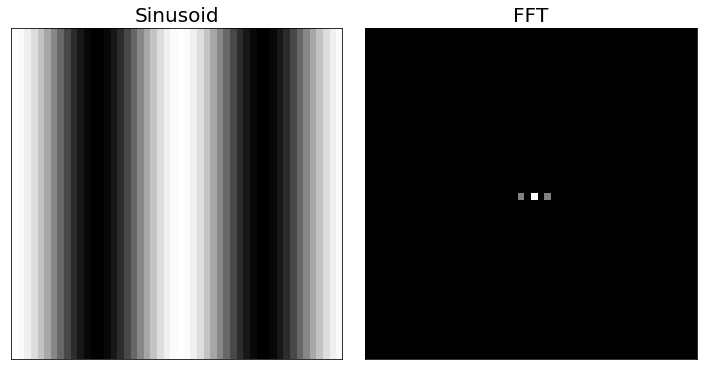

In [34]:
A = 1
f = 2
phi = 0
s_img = sinusoid(A,f,phi,50)
s_img_fft,_shifted,_dis,_ = fft(s_img,False)
plot_grid([s_img,_dis],["Sinusoid","FFT"])

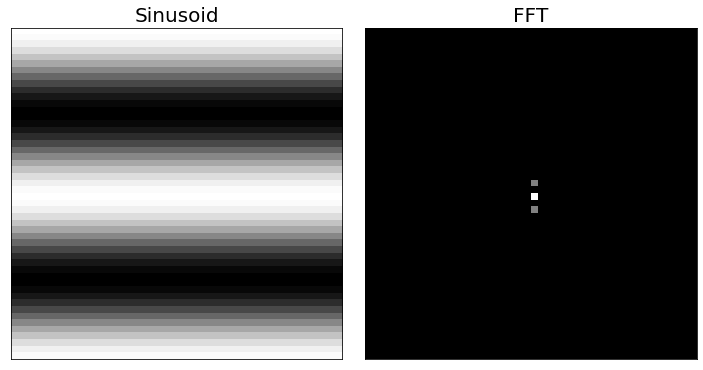

In [35]:
s_img_fft,_shifted,_dis,_ = fft(s_img.T,False)
plot_grid([s_img.T,_dis],["Sinusoid","FFT"])

### High pass filter and Low pass filter

In [36]:
import numpy.fft as fp

def createCircularMask(h, w, center, radius):
    """
    Create circular mask
    """
    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)
    mask = dist_from_center <= radius
    return mask

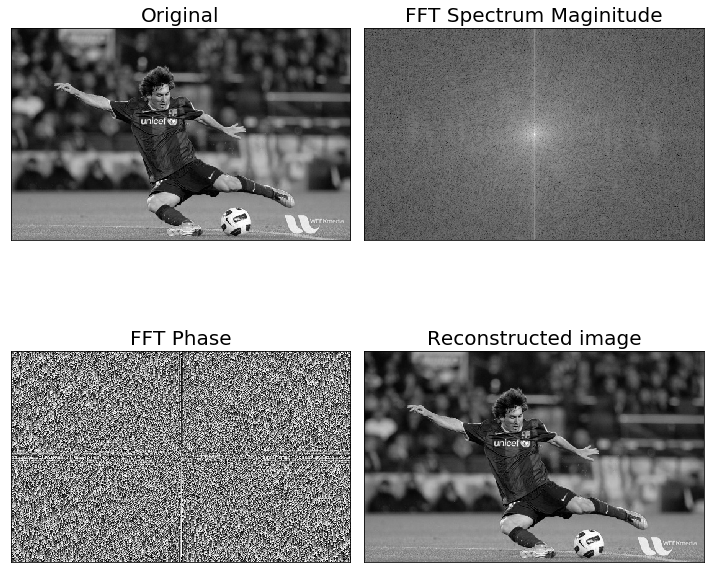

In [37]:
# reading messi image
messi = imread("imgs/messi2.jpg",True)
# convert to fft, and get fft_image, _shifted_image, log_image for displaying and angle image
messi_fft,_shifted,_log,a = fft(green(messi))
# reversing fft to spatial
messi_rec = reverse_fft(messi_fft) 
plot_grid([green(messi),_log,a,messi_rec],
          ["Original","FFT Spectrum Maginitude",
           "FFT Phase","Reconstructed image"])

In [38]:
# circular mask
h,w,_ = messi.shape
center = [int(w/2), int(h/2)]
mask = createCircularMask(h, w, center=center,radius=40)

In [39]:
# fft 
messi_fft,_shifted,_log,a = fft(green(messi))

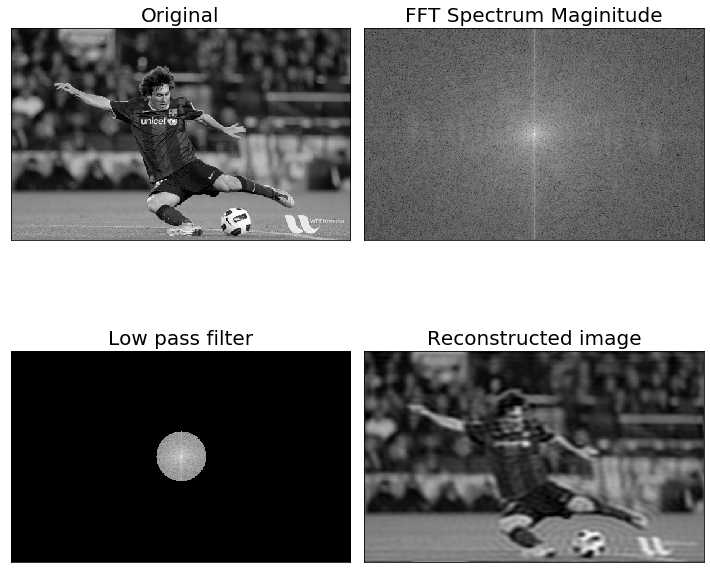

In [40]:
# low pass filter
lowpass_d = mask*_log
lowpass = mask*_shifted
lowpass_ishift = np.fft.ifftshift(lowpass)
messi_rec = reverse_fft(lowpass_ishift) 
plot_grid([green(messi),_log,lowpass_d,messi_rec],
          ["Original","FFT Spectrum Maginitude",
           "Low pass filter","Reconstructed image"])

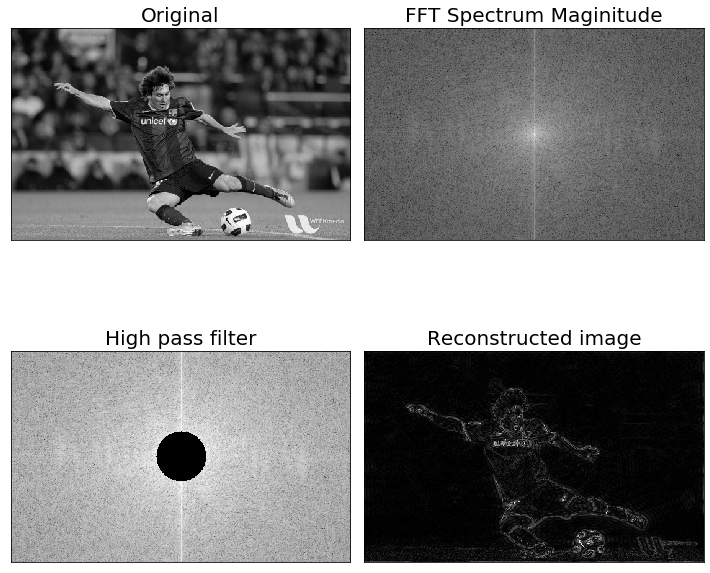

In [41]:
# high pass filter
hmask = ~mask
highpass_d = hmask*_log
highpass = hmask*_shifted
highpass_ishift = np.fft.ifftshift(highpass)
messi_rec = reverse_fft(highpass_ishift) 
plot_grid([green(messi),_log,highpass_d,messi_rec],
          ["Original","FFT Spectrum Maginitude",
           "High pass filter","Reconstructed image"])

### Image denoising with FFT

In [42]:
# loading image
moonlanding = imread("imgs/moonlanding.png",True)
moonlanding_fft,_shifted,_log,a = fft(moonlanding)
# circular mask
h,w = moonlanding.shape
center = [int(w/2), int(h/2)]
mask = createCircularMask(h, w, center=center,radius=35)

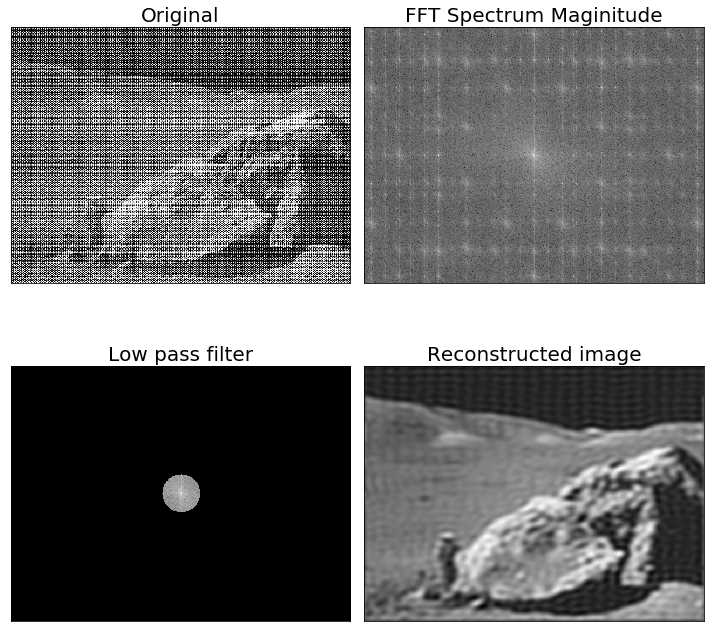

In [43]:
# low pass filter
from skimage import exposure
lowpass_d = mask*_log
lowpass = mask*_shifted
lowpass_ishift = np.fft.ifftshift(lowpass)
moonlanding_rec = reverse_fft(lowpass_ishift) 
plot_grid([moonlanding,_log,lowpass_d,moonlanding_rec],
          ["Original","FFT Spectrum Maginitude",
           "Low pass filter","Reconstructed image"])

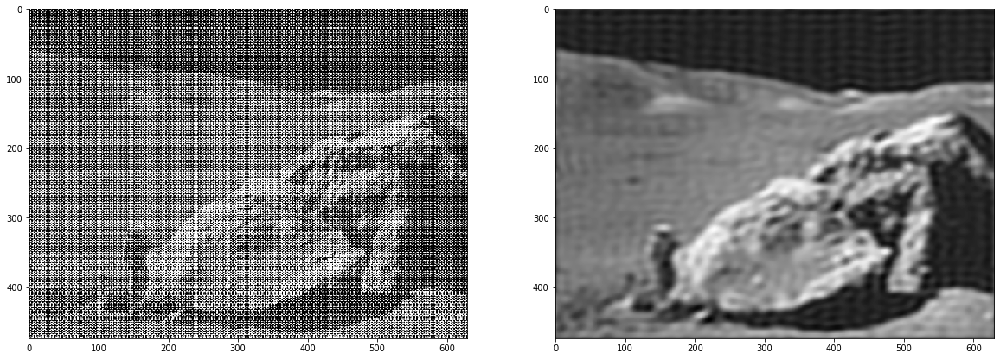

In [48]:
# applying median filter to improve it further
from scipy import ndimage
fig,ax = plt.subplots(ncols=2,figsize=(20,20))
moonlanding_median = ndimage.median_filter(moonlanding_rec,(5,5))
ax[0].imshow(moonlanding,cmap="gray")
ax[1].imshow(moonlanding_median,cmap="gray")

## Image gradient

In [49]:
def grad_x(img):
    """
    Naive implementation of gradient in x-direction
    """
    img2 = img.astype(np.float)
    dimg = np.zeros(img.shape).astype(np.float)
    for i in range(img2.shape[0]):
        y = img2[i,:]
        x = np.arange(img2.shape[1]).astype(np.float)
        dy = np.zeros(y.shape,np.float).astype(np.float)
        dy[0:-1] = np.diff(y)/np.diff(x)
        dy[-1] = (y[-1] - y[-2])/(x[-1] - x[-2])
        dimg[i] = dy
    return dimg
def grad_y(img):
    """
    Naive implementation of gradient in y-direction
    """
    img2 = img.astype(np.float)
    dimg = np.zeros(img.shape).astype(np.float)
    for i in range(img2.shape[1]):
        y = img2[:,i]
        x = np.arange(img2.shape[0]).astype(np.float)
        dy = np.zeros(y.shape,np.float).astype(np.float)
        dy[0:-1] = np.diff(y)/np.diff(x)
        dy[-1] = (y[-1] - y[-2])/(x[-1] - x[-2])
        dimg[:,i] = dy
    return dimg

def grad_mag(grad_x,grad_y):
    """
    returns the amount of change in the gradient
    """
    return np.sqrt(grad_x**2+grad_y**2)

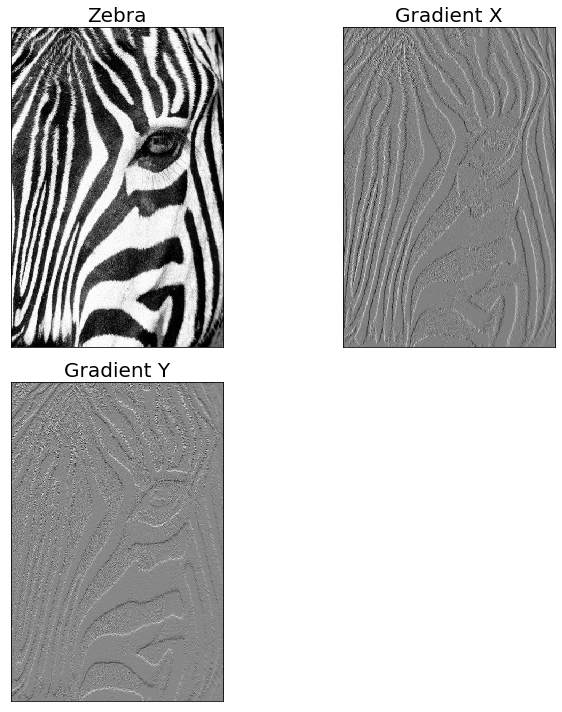

In [50]:
# reading zebra image
zebra = imread("imgs/zebra.jpg",True)
# graying
zebra_gray = gray(zebra)
# calculating x gradient
zebra_gx = grad_x(zebra_gray)
# calculating y gradient
zebra_gy = grad_y(zebra_gray)
# plotting
plot_grid([zebra_gray,zebra_gx,zebra_gy],["Zebra","Gradient X","Gradient Y"])

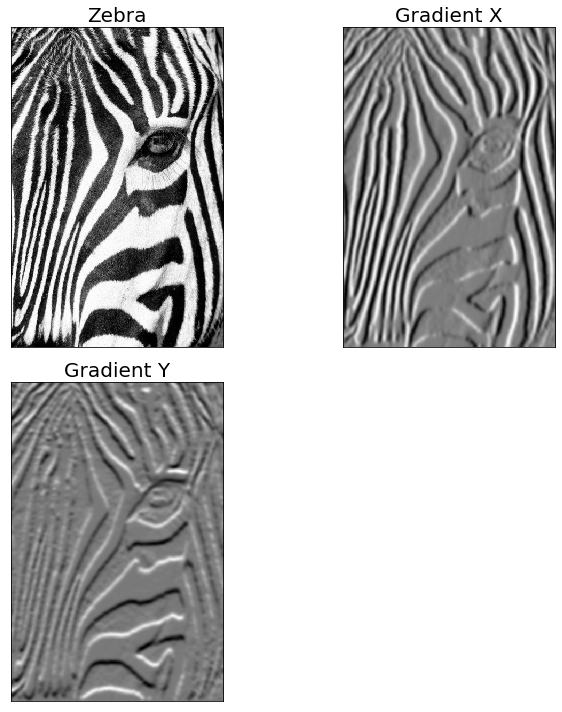

In [51]:
# taking blurred image before calculating gradient to get sharper images
zebra_blur = ndimage.gaussian_filter(zebra_gray,sigma=3)
# gradient x
zebra_gx = grad_x(zebra_blur)
# gradient y
zebra_gy = grad_y(zebra_blur)
plot_grid([zebra_gray,zebra_gx,zebra_gy],["Zebra","Gradient X","Gradient Y"])

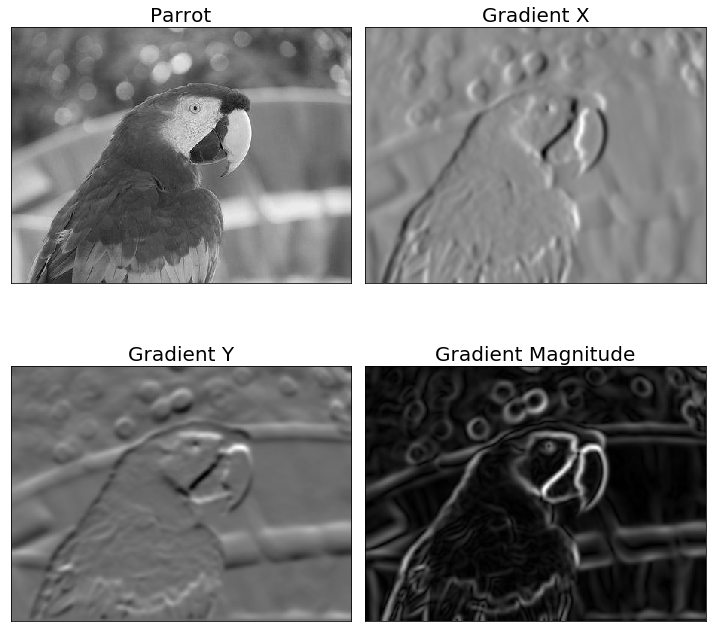

In [52]:
# reading parrot image
parrot = imread("imgs/parrot.jpg",True)
# graying
parrot_gray = gray(parrot)
# blurring
parrot_blur = ndimage.gaussian_filter(parrot_gray,sigma=3)
# calculating gradient x
parrot_gx = grad_x(parrot_blur)
# calculating gradient y
parrot_gy = grad_y(parrot_blur)
# calculating gradient magnitude
parrot_mag = grad_mag(parrot_gx,parrot_gy)
plot_grid([parrot_gray,parrot_gx,parrot_gy,parrot_mag],
          ["Parrot","Gradient X","Gradient Y","Gradient Magnitude"])

## Convolution

Think of it this way — an image is just a multi-dimensional matrix. Our image has a width (# of columns) and a height (# of rows), just like a matrix.

But unlike the traditional matrices you may have worked with back in grade school, images also have a depth to them — the number of channels in the image. For a standard RGB image, we have a depth of 3 — one channel for each of the Red, Green, and Blue channels, respectively.

Given this knowledge, we can think of an image as a big matrix and kernel or convolutional matrix as a tiny matrix that is used for blurring, sharpening, edge detection, and other image processing functions.


<img src="imgs/convolutions_kernel_sliding.jpg" width=200/>

For more explanation go to <a href="https://www.pyimagesearch.com/2016/07/25/convolutions-with-opencv-and-python/">pyimagesearch</a>

In [53]:
from scipy.signal import convolve2d
from scipy import signal
def convolve(img,kernal,mode="constant"):
    return np.clip(convolve2d(img,kernal),0,1)
def convolve_color(im, window):
    """
    Convolves im with window, over all three colour channels
    """
    ims = []
    for d in range(3):
        im_conv_d = np.clip(convolve2d(im[:,:,d], window, mode="same", boundary="symm"),0,255)
        ims.append(im_conv_d)
    im_conv = np.stack(ims, axis=2).astype("uint8")
    return im_conv

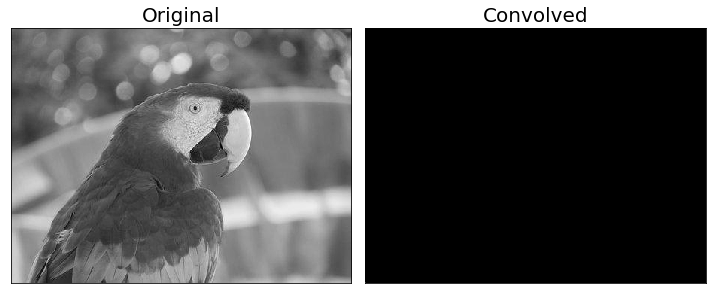

In [54]:
# Try random kernal. Run multiple times to observe
r_kernal = np.random.randint(-2,2,9).reshape((3,3))
# reading parrot
parrot = imread("imgs/parrot.jpg",True)
# graying
parrot_gray = gray(parrot)
# convolving
parrot_con = convolve(parrot_gray,r_kernal)
plot_grid([parrot_gray,parrot_con],["Original","Convolved"])

In [55]:
# construct the Laplacian kernel used to detect edge-like
# regions of an image
laplacian = np.array((
    [0, 1, 0],
    [1, -4, 1],
    [0, 1, 0]), dtype="int")
# construct the Sobel x-axis kernel
sobelX = np.array((
 [-1, 0, 1],
 [-2, 0, 2],
 [-1, 0, 1]), dtype="int")
# construct the Sobel y-axis kernel
sobelY = np.array((
    [-1, -2, -1],
    [0, 0, 0],
    [1, 2, 1]), dtype="int")
# construct average blurring kernels used to smooth an image
smallBlur = np.ones((7, 7), dtype="float") * (1.0 / (7 * 7))
largeBlur = np.ones((21, 21), dtype="float") * (1.0 / (21 * 21))
# construct a sharpening filter
sharpen_1 = np.array((
    [0, -1, 0],
    [-1, 5, -1],
    [0, -1, 0]), dtype="int")
sharpen_15 = 1.5*sharpen_1
sharpen_2 = 2*sharpen_1

#emboss kernal
emboss = np.array([[-2,-1,0],[-1,1,1],[0,1,2]])
#edge schar kernal
edge_schar = np.array([[ -3-3j, 0-10j, +3 -3j], [-10+0j, 0+ 0j, +10+0j], [ -3+3j, 0+10j, +3 +3j]])

# DoG kernal
x = np.linspace(-10, 10, 15)
kernel_1d = np.exp(-0.005*x**2)
kernel_1d /= np.trapz(kernel_1d) # normalize the sum to 1
gauss_kernel1 = kernel_1d[:, np.newaxis] * kernel_1d[np.newaxis, :]
kernel_1d = np.exp(-5*x**2)
kernel_1d /= np.trapz(kernel_1d) # normalize the sum to 1
gauss_kernel2 = kernel_1d[:, np.newaxis] * kernel_1d[np.newaxis, :]
DoGKernel = gauss_kernel1[:, :] - gauss_kernel2[:, :]


# construct the kernel bank, a list of kernels we're going
# to applY
kernelBank = {
    "small_blur": smallBlur,
    "large_blur": largeBlur,
    "sharpen_1": sharpen_1,
    "sharpen_1.5": sharpen_15,
    "sharpen_2": sharpen_2,
    "laplacian": laplacian,
    "sobel_x": sobelX,
    "sobel_y": sobelY,
    "emboss": emboss,
    "edge_schar": edge_schar,
    "dog": DoGKernel
}

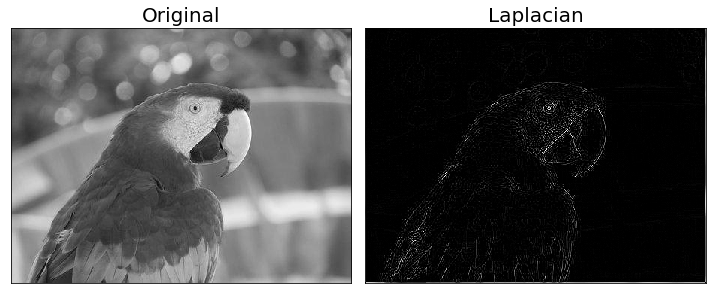

In [56]:
# laplacian
img = parrot_gray
parrot_lapl = convolve(img,kernelBank["laplacian"])
plot_grid([img,parrot_lapl],["Original","Laplacian"])

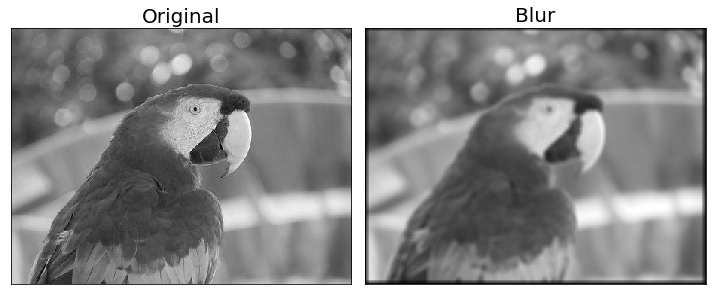

In [57]:
# small blur 
img = parrot_gray
parrot_blur = convolve(img,kernelBank["small_blur"])
plot_grid([img,parrot_blur],["Original","Blur"])

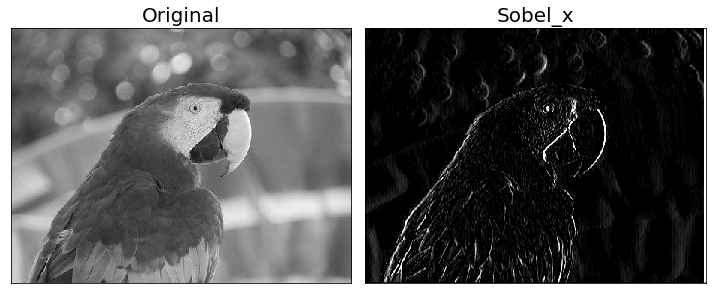

In [58]:
# sobel x
img = parrot_gray
parrot_sobel_x = convolve(img,kernelBank["sobel_x"])
plot_grid([img,parrot_sobel_x],["Original","Sobel_x"])

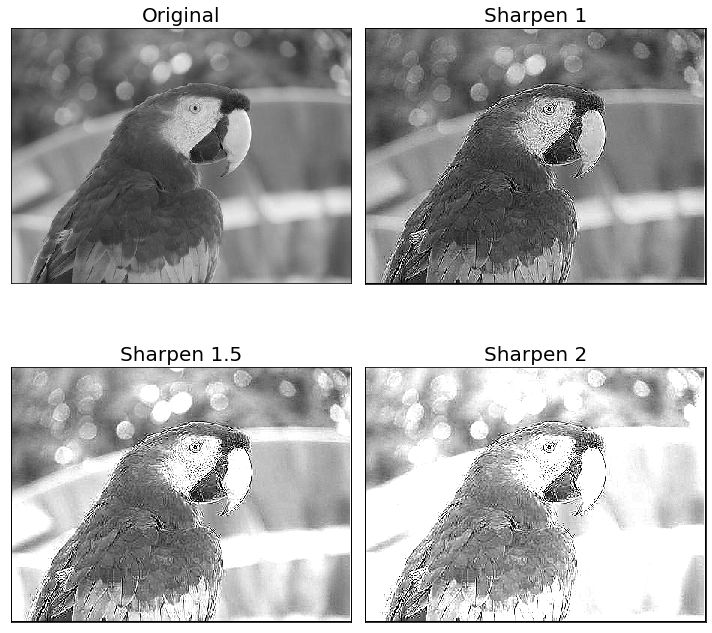

In [59]:
# sharpen
img = parrot_gray
parrot_sharp_1 = convolve(img,kernelBank["sharpen_1"])
parrot_sharp_15 = convolve(img,kernelBank["sharpen_1.5"])
parrot_sharp_2 = convolve(img,kernelBank["sharpen_2"])
plot_grid([img,parrot_sharp_1,parrot_sharp_15,parrot_sharp_2],["Original","Sharpen 1","Sharpen 1.5","Sharpen 2"])

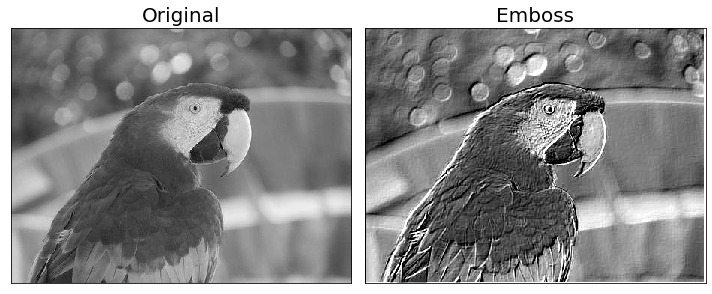

In [60]:
# emboss
img = parrot_gray
parrot_emboss = convolve(img,kernelBank["emboss"])
plot_grid([img,parrot_emboss],["Original","Emboss"])

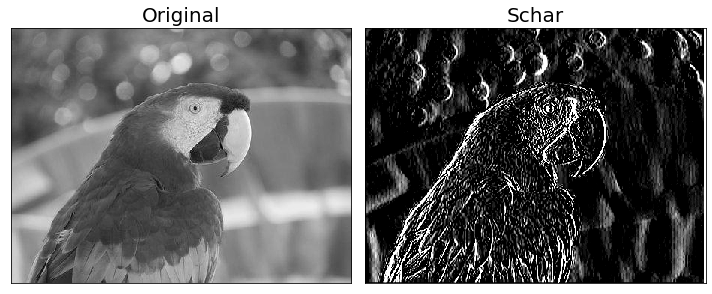

In [61]:
# schar
img = parrot_gray
parrot_schar = np.real(convolve(img,kernelBank["edge_schar"]))
plot_grid([img,parrot_schar],["Original","Schar"])

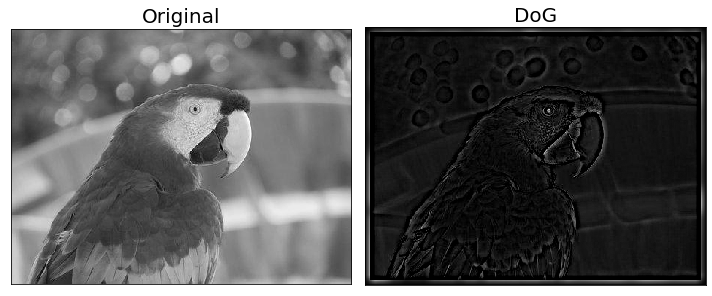

In [62]:
# DoG
img = parrot_gray
parrot_dog = convolve(img,kernelBank["dog"])
plot_grid([img,parrot_dog],["Original","DoG"])

##  Mophological Image Processing

### Dilation and Erosion

#### Mathematical Morphology

Two basic operations

- Dilation
- Erosion

And several composite relations

- <font color="blue">Closing and opeining</font>
- Thinning and thickening
...


#### Dilation

Dilation <font color="green">expands</font> the connected sets of 1s of a binary image.

It can be used for:
- Growing features
- Filling holes and gaps

<br/>
<figure>
    <img src="imgs/L9100.png" width=300/>
    <center><figcaption>Fig 38(a)</figcaption></center>
</figure>

### Errosion

Erosion <font color="green">shrinks</font> the connected sets of 1s of a binary image.

It can be used for:
- Shrinking features
- Removing bridges, branches, protrusions


<br/>
<figure>
    <img src="imgs/L9101.png" width=300/>
    <center><figcaption>Fig 38(b)</figcaption></center>
</figure>

In [63]:
from scipy.ndimage.morphology import grey_erosion
from scipy.ndimage.morphology import grey_dilation

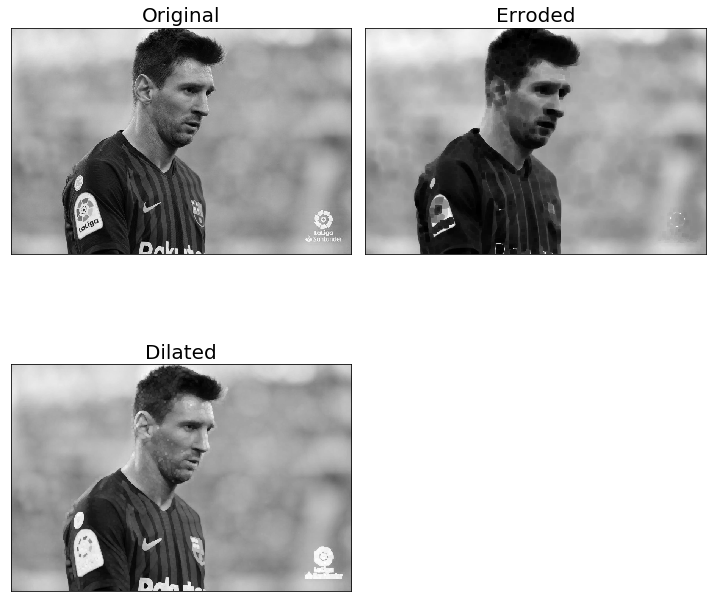

In [64]:
# Reading the input image 
sadmessi = gray(imread('imgs/sad_messi.JPG',True))

sadmessi_er = grey_erosion(sadmessi, size=(9,9)) 
sadmessi_dil = grey_dilation(sadmessi, size=(5,5)) 

plot_grid([sadmessi,sadmessi_er,sadmessi_dil],["Original","Erroded","Dilated"])

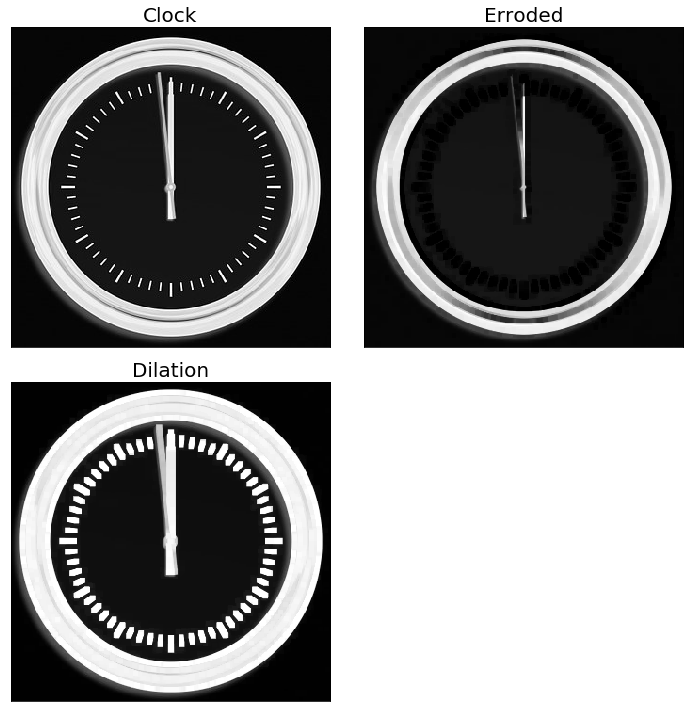

In [65]:
# improve moonlanding
clock = gray(imread("imgs/clock2.jpg",True))
clock_bin = clock.copy()
clock_er = grey_erosion(clock,size=(5,5)) 
clock_dil = grey_dilation(clock,size=(5,5)) 
plot_grid([clock,clock_er,clock_dil],["Clock","Erroded","Dilation"])